In [1]:
import os
import random
import IPython
import scipy.io.wavfile as wav
import soundfile as sf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from python_speech_features import mfcc as MFCC
from python_speech_features import delta as DELTA
from python_speech_features import logfbank

from sklearn.mixture import GaussianMixture as GMM
import pickle
import pandas as pn

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import IPython.display
import sklearn
import librosa
import librosa.display
from python_speech_features import mfcc as MFCC
from python_speech_features import delta as DELTA
from python_speech_features import logfbank
import scipy.io.wavfile as wav
import soundfile as sf
import glob
from sklearn.mixture import GaussianMixture as GMM

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from sklearn.utils import shuffle
from sklearn.model_selection import GridSearchCV

In [3]:
# read n amount of audio clips from directory
# return array with shape (nx2) -> [:,0]=signals, [:,1]=sample_rates
def read_audio(path):
    path = path
    files = os.listdir(path)
    
    N = len(files)
    #random.seed(100)
    audio_clips = []
    for n in range(N):
        #index = random.randrange(0, len(files))
        #print(files[index])

        try:
#             rate, sig = wav.read(path + "\\" + files[n])
            sig, rate = librosa.load(path + "\\" + files[n], sr=16000)
            if len(sig) > rate:
#                 audio_clips.append((sig.astype(float),rate))
                audio_clips.append((sig,rate))

        #IPython.display.Audio(data=sig, rate = rate)
        except:
            print("File could not be read")

    audio_clips = np.asarray(audio_clips) # convert to numpy array
    #print(audio_clips.shape)
    
    return audio_clips

In [4]:
def split_audio(audio_clip, rate, time):
    samples = time*rate
    #print(samples)
    time_frames = []
    N = len(audio_clip)//samples
    for n in range(N):
        n1 = n*samples
        n2 = n1 + samples
        if n2 <= len(audio_clip):
            time_frames.append(audio_clip[n1:n2])
        else:
            print("The last ... seconds coould not fit to %f second frame")
    time_frames = np.asarray(time_frames)  
    return time_frames

In [5]:
def normalize_audio(segmented_clips):
    for i in range(len(segmented_clips)):      
        for j in range(len(segmented_clips[i])):
            segmented_clips[i][j,:] = segmented_clips[i][j,:]/np.max(np.abs(segmented_clips[i][j,:]))
    return segmented_clips

In [6]:
def mfcc(segments,rate,norm=True):
    #print(segments.shape)
    mfccs_clip = []
    for i in range(len(segments)):
        mfccs = MFCC(segments[i],rate, 0.025, 0.01,20,appendEnergy = False, nfilt=32)
        
        deltas = delta(mfccs) #
        delta_deltas = delta_delta(deltas)
        mfccs_clip.append(np.concatenate((mfccs,deltas,delta_deltas),axis=1))
#         mfccs_clip.append(mfccs)
    mfccs_clip = np.asarray(mfccs_clip)
    
    return mfccs_clip

In [7]:
def delta(mfccs):
    deltas = DELTA(mfccs,N=3)
    return deltas
    
    

In [8]:
def delta_delta(delta):
    deltas = DELTA(delta, N=3)
    return deltas

In [9]:
def postprocess(clip):
    for i in range(len(clip)):
        if i < len(clip) - 3 and i>1:
            if(clip[i-1] == 0 and clip[i+1] == 0):
                    clip[i] = 0
    
#         if i < len(clip) - 3 and i>1:
#             if(clip[i-1] == 1 and clip[i+1] == 1):
#                     clip[i] = 1
    return clip

In [10]:
def hzcrr(segments):
    zcr_ar = []
    for x in range(len(segments)):
        zcr = librosa.feature.zero_crossing_rate(segments[x]+0.0001)
        zcr = zcr.reshape(-1)
        zcr_ar.append(zcr)
    zcr_ar = np.array(zcr_ar)
    
    
    
    av_zcr_ar = np.average(zcr_ar,axis=1)
    #print(av_zcr_ar.shape)
    N = np.shape(zcr_ar)[1]
    #print(N)

    hzcrr_ar = np.zeros((np.shape(zcr_ar)[0]),dtype=float)
    #print(hzcrr_ar)
    for i in range(np.shape(zcr_ar)[0]):
        #print(zcr_ar[i,:])
        hzcrr_ar[i] = 1/(2*N)*np.sum(np.sign(zcr_ar[i,:]-1.5*av_zcr_ar[i])+1)
    #data = hzcrr_ar   
    return hzcrr_ar
    #print(zcr_ar.shape)

In [11]:
def stEnergy(frame):
    """Computes signal energy of frame"""
    #print(len(frame))
    #print(np.sum(np.abs(frame ** 2)) / np.float64(len(frame)))
    return np.sum(np.abs(frame ** 2)) / np.float64(len(frame))

def calcFrames(signal,length):
    #print(len(signal))
    #print(length)
    if len(signal) % length != 0:
        print("Signal length not dividable by frame length")
    else:
        frames = np.zeros((int(len(signal)/length),length),dtype=float)
        #print(frames.shape)
        #print(signal.shape)
        #signal = signal.reshape(-1,1)
        #print(signal.shape)
        for n in range(len(frames)):
            #print(len(signal[n*length:n*length+length]))
            frames[n,:] = signal[n*length:n*length+length]
    return frames

def calcFramesEnergy(frames):
    frame_energy = []
    for n in range(len(frames)):
        frame_energy.append(stEnergy(frames[n]))
    #print(frames_energy[0:10])    
    return np.array(frame_energy,dtype=float)

def avg_stEnergy(frame_energy):
    #print(np.average(frame_energy))
    return np.average(frame_energy)

def lster(frame_energy):
    N = np.shape(frame_energy)[0]
    #lster_ar = np.zeros((N),dtype=float)
    avg_e = avg_stEnergy(frame_energy)
    #print(lster_ar.shape)
    lster = 1/(2*N)*np.sum(np.sign(0.5*avg_e - frame_energy)+1)
    #print(np.sum(np.sign(0.5*avg_e - frame_energy)))
        #print(1/(2*N)*np.sum(np.sign(0.5*avg_e - frame_energy[n])+1))
    return lster

In [90]:
path =r"D:\Own set\Music_Train"
audio_clips = read_audio(path)
print(audio_clips[0,0])
IPython.display.Audio(data=audio_clips[0][0],rate=audio_clips[0,1])

[0. 0. 0. ... 0. 0. 0.]


In [91]:
segmented_clips = []
for i in range(len(audio_clips)):
    segmented_clips.append(split_audio(audio_clips[i,0],audio_clips[i,1], 1))

segmented_clips = np.asarray(segmented_clips)
print(len(segmented_clips))

80


(283, 16000)


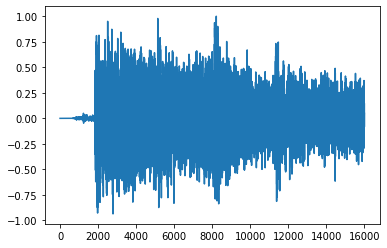

In [92]:
norm_segmented_clips = normalize_audio(segmented_clips)
plt.plot(norm_segmented_clips[0][0,:])
print(norm_segmented_clips[0].shape)
IPython.display.Audio(data=norm_segmented_clips[0][0,:],rate=audio_clips[0,1])

In [94]:
mfccs_music  = []

for i in range(len(norm_segmented_clips)):
    x = mfcc(norm_segmented_clips[i],16000,norm=True)
    y = hzcrr(norm_segmented_clips[i])  
    
        #####LSTER#######
    signal = norm_segmented_clips[i]
    lster_signal = []
    for j in range(len(signal)):
        frames = calcFrames(signal[j],400)
        frames_energy = calcFramesEnergy(frames)
        avg_ste = avg_stEnergy(frames_energy)
        lster_sig = lster(frames_energy)
        lster_signal.append(lster_sig)
    lster_signal = np.array(lster_signal)
    
    
    z = np.zeros((len(x),99))
    q = np.zeros((len(x),99))
    #print(z.shape)
    for k in range(len(z)):
        z[k] = y[k]
        q[k] = lster_signal[k]    
    p = np.dstack((x,z))
    w = np.dstack((p,q))
    print(w.shape)    

    mfccs_music.append(w)    
    
    
    
    


(283, 99, 62)
(182, 99, 62)
(360, 99, 62)
(145, 99, 62)
(170, 99, 62)
(318, 99, 62)
(304, 99, 62)
(308, 99, 62)
(175, 99, 62)
(224, 99, 62)
(238, 99, 62)
(220, 99, 62)
(252, 99, 62)
(207, 99, 62)
(227, 99, 62)
(238, 99, 62)
(166, 99, 62)
(207, 99, 62)
(190, 99, 62)
(284, 99, 62)
(160, 99, 62)
(99, 99, 62)
(96, 99, 62)
(157, 99, 62)
(86, 99, 62)
(102, 99, 62)
(353, 99, 62)
(251, 99, 62)
(330, 99, 62)
(250, 99, 62)
(261, 99, 62)
(281, 99, 62)
(369, 99, 62)
(465, 99, 62)
(134, 99, 62)
(128, 99, 62)
(163, 99, 62)
(280, 99, 62)
(471, 99, 62)
(307, 99, 62)
(354, 99, 62)
(165, 99, 62)
(376, 99, 62)
(294, 99, 62)
(422, 99, 62)
(371, 99, 62)
(409, 99, 62)
(178, 99, 62)
(176, 99, 62)
(191, 99, 62)
(177, 99, 62)
(204, 99, 62)
(197, 99, 62)
(174, 99, 62)
(200, 99, 62)
(168, 99, 62)
(339, 99, 62)
(460, 99, 62)
(360, 99, 62)
(171, 99, 62)
(307, 99, 62)
(150, 99, 62)
(46, 99, 62)
(216, 99, 62)
(255, 99, 62)
(228, 99, 62)
(106, 99, 62)
(169, 99, 62)
(161, 99, 62)
(52, 99, 62)
(156, 99, 62)
(230, 99, 6

In [95]:
mfccs_music = np.asarray(mfccs_music) #array of mfcc for each 1 second clip of audio file
print(mfccs_music[0].shape)

(283, 99, 62)


In [96]:
mfccs_music_reshape = []
for i in range(len(norm_segmented_clips)):
    a,b,c = np.shape(mfccs_music[i])
    mfccs_music_reshape.append(np.reshape(mfccs_music[i], (a*b,c)))

mfccs_music_reshape = np.asarray(mfccs_music_reshape) # array of all 1 second clip mfcc for length of audio
print(mfccs_music_reshape[0].shape)

(28017, 62)


In [97]:
n = len(mfccs_music_reshape)
all_mfccs_music = np.concatenate(mfccs_music_reshape[np.linspace(0,n-1,num=n,dtype=int)])
print(all_mfccs_music.shape)

(1829718, 62)


In [98]:
#np.random.shuffle(all_mfccs_music)
music_train_x = all_mfccs_music
print(music_train_x.shape)
music_train_y = np.ones((len(music_train_x)),dtype=int)
print(music_train_y.shape)

(1829718, 62)
(1829718,)


In [99]:
path =r"D:\Own set\Speech_Train2"
audio_clips = read_audio(path)
IPython.display.Audio(data=audio_clips[0][0],rate=audio_clips[0,1])

In [100]:
segmented_clips = []
for i in range(len(audio_clips)):
    segmented_clips.append(split_audio(audio_clips[i,0],audio_clips[i,1], 1))

segmented_clips = np.asarray(segmented_clips)
print(len(segmented_clips))

44


(328, 16000)


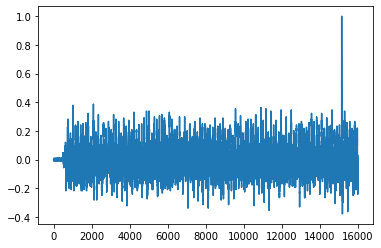

In [101]:
norm_segmented_clips = normalize_audio(segmented_clips)
plt.plot(norm_segmented_clips[0][0,:])
print(norm_segmented_clips[0].shape)
IPython.display.Audio(data=norm_segmented_clips[0][1,:],rate=audio_clips[0,1])

In [102]:
mfccs_speech  = []

for i in range(len(norm_segmented_clips)):
    x = mfcc(norm_segmented_clips[i],16000,norm=True)
    y = hzcrr(norm_segmented_clips[i])  
    
        #####LSTER#######
    signal = norm_segmented_clips[i]
    lster_signal = []
    for j in range(len(signal)):
        frames = calcFrames(signal[j],400)
        frames_energy = calcFramesEnergy(frames)
        avg_ste = avg_stEnergy(frames_energy)
        lster_sig = lster(frames_energy)
        lster_signal.append(lster_sig)
    lster_signal = np.array(lster_signal)
    
    
    z = np.zeros((len(x),99))
    q = np.zeros((len(x),99))
    #print(z.shape)
    for k in range(len(z)):
        z[k] = y[k]
        q[k] = lster_signal[k]    
    p = np.dstack((x,z))
    w = np.dstack((p,q))
    print(w.shape)    

    mfccs_speech.append(w)  

(328, 99, 62)
(578, 99, 62)
(642, 99, 62)
(583, 99, 62)
(604, 99, 62)
(980, 99, 62)
(361, 99, 62)
(520, 99, 62)
(598, 99, 62)
(132, 99, 62)
(322, 99, 62)
(226, 99, 62)
(410, 99, 62)
(254, 99, 62)
(600, 99, 62)
(387, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(600, 99, 62)
(600, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(367, 99, 62)
(552, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(617, 99, 62)
(595, 99, 62)
(602, 99, 62)
(599, 99, 62)
(599, 99, 62)
(576, 99, 62)
(601, 99, 62)
(126, 99, 62)
(600, 99, 62)
(231, 99, 62)


In [103]:
mfccs_speech = np.asarray(mfccs_speech) #array of mfcc for each 1 second clip of audio file

In [104]:
# Reshape to create array of mfccs of all audio
mfccs_speech_reshape = []
for i in range(len(norm_segmented_clips)):
    a,b,c = np.shape(mfccs_speech[i])
    #print(b,c)
    mfccs_speech_reshape.append(np.reshape(mfccs_speech[i], (a*b,c)))

mfccs_speech_reshape = np.asarray(mfccs_speech_reshape) # array of all 1 second clip mfcc for length of audio
print(mfccs_speech_reshape[0].shape)

(32472, 62)


In [105]:
# Reshape to create 2d array of all mfccs of all audio files
n = len(mfccs_speech_reshape)
all_mfccs_speech = np.concatenate(mfccs_speech_reshape[np.linspace(0,n-1,num=n,dtype=int)])
print(all_mfccs_speech.shape)

(2294721, 62)


In [106]:
np.random.shuffle(all_mfccs_speech)
speech_train_x = all_mfccs_speech
print(speech_train_x.shape)
speech_train_y = np.zeros((len(speech_train_x)),dtype=int)
print(speech_train_y.shape)

(2294721, 62)
(2294721,)


In [29]:
X_train = np.concatenate((speech_train_x,music_train_x),axis=0)
Y_train = np.concatenate((speech_train_y,music_train_y))
print(X_train.shape)
print(Y_train.shape)
with open('X_train.data', 'wb') as filehandle:
    # store the data as binary data stream
    pickle.dump(X_train, filehandle)
    
with open('Y_train.data', 'wb') as filehandle:
    # store the data as binary data stream
    pickle.dump(Y_train, filehandle)

(4124439, 62)
(4124439,)


In [38]:
#Logistic regression

In [33]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from sklearn.utils import shuffle
from sklearn.model_selection import GridSearchCV

In [4]:
import numpy as np
from sklearn.metrics.pairwise import check_pairwise_arrays
from numba import vectorize

# @vectorize(['float32(float32, float32)'], target='cuda')
def anova_kernel(X, Y=None, gamma=None, p=1):
    X, Y = check_pairwise_arrays(X, Y)
    if gamma is None:
        gamma = 1. / X.shape[1]
        
    X = np.array(X, dtype='float16')
    Y = np.array(Y, dtype='float16')
    diff = X[:, None, :] - Y[None, :, :]
    print("%d Gbytes" % (diff.size/10e6 * diff.itemsize))

    
    diff **= 2
    diff *= -gamma
    np.exp(diff, out=diff)
    K = diff.sum(axis=2)
    K **= p
    return K

#     x, y = check_pairwise_arrays(x, y)
#     if gamma is None:
#         gamma = 1. / X.shape[1]
        
#     out = np.zeros((x.shape[0], y.shape[0]), dtype='float32')
#     for i in range(0, len(x)):
#         for j in range(0, len(y)):
            
#             out[i][j] = np.exp(np.sum(-1.0*np.square(np.subtract(x[i], y[j]))))
# #             print(out[i][j])
#     return out.astype('float32')


In [3]:
from scipy.linalg import cholesky
from sklearn.linear_model import LogisticRegression

# make X the matrix of all data points, train + test

with open('X_train.data', 'rb') as filehandle:
    X_train = pickle.load(filehandle)
with open('X_test.data', 'rb') as filehandle:
    X_test = pickle.load(filehandle)
with open('Y_train.data', 'rb') as filehandle:
    Y_train = pickle.load(filehandle)
with open('Y_test.data', 'rb') as filehandle:
    Y_test = pickle.load(filehandle)  

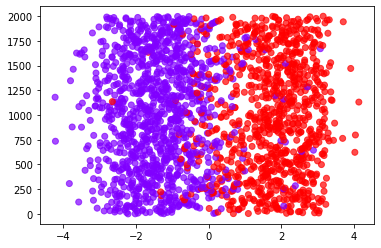

In [35]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
X_train, Y_train = shuffle(X_train, Y_train, random_state = 1)
clf = LDA()
x = clf.fit_transform(X_train[:2000],Y_train[:2000])
y = Y_train[:2000]
plt.scatter(x, np.arange(0,2000,1), c=y,
    cmap='rainbow',
    alpha=0.7,
    )


In [23]:
clf.predict(X_test)

array([1, 1, 1, ..., 1, 1, 1])

In [6]:
#from bottom x_test is speech and non-speech mixed with y_test corresponding
# less samples
X_test, Y_test = shuffle(X_test, Y_test, random_state = 1)
X_test = X_test[:2400,:20]
Y_test = Y_test[:2400]

# do same with training but first randomize
X_train, Y_train = shuffle(X_train, Y_train, random_state = 1)
X_train = X_train[:12000,:20]
Y_train = Y_train[:12000]

X = np.concatenate((X_train,X_test), axis=0)

print(X.shape)
# train is indices of train points, test of test

(14400, 20)


In [46]:
from sklearn.kernel_approximation import Nystroem
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
K_train = anova_kernel(X_train)
K_test = anova_kernel(X_test, X_train)


576 Gbytes
115 Gbytes


In [140]:
# from sklearn.kernel_approximation import Nystroem
# from sklearn.linear_model import LogisticRegression
# from sklearn.pipeline import Pipeline

# X_train = np.array(X_train, dtype='float16')
# test = X_train[:1000,None,:]-X_train[None,:1000,:]
# print("%d Gbytes" % (test.size/10e6 * test.itemsize))
clf = Pipeline([
    ('nys', Nystroem(kernel='rbf', gamma=0.01, degree=1, n_components=100)),
    ('lr', LogisticRegression(solver='lbfgs', C=100, max_iter=500))])
clf.fit(K_train, Y_train)

preds = clf.predict(K_test[:2400])
print(accuracy_score(preds,Y_test[:2400]))
# print(precision_score(preds,Y_test[:2400]))

0.725


In [336]:
# print(K_train.shape)
# preds = clf.predict(K_test)
# print(accuracy_score(preds,Y_test))

In [91]:
# models = []
# param = [['lbfgs','10'],['lbfgs','1'],['lbfgs','0.01'],
#          ['liblinear','10'],['liblinear','1'],['liblinear','0.01'],
#          ['saga','10'],['saga','1'],['saga','0.01']
#         ]

# for i in range(len(param)):
#     lr = LogisticRegression(n_jobs=-1, verbose=2, solver=param[i][0], C=float(param[i][1]), max_iter=1000)
#     models.append(lr)
    


In [318]:
X_train_shuffle, Y_train_shuffle = shuffle(X_train, Y_train, random_state=1)
print(Y_train_shuffle.shape)

(5186412,)


In [92]:
# lr.fit(X_train_shuffle[:72000],Y_train_shuffle[:72000])

for i in range(len(models)):
    models[i].fit(X_train_shuffle[:72000],Y_train_shuffle[:72000])
    predict = models[i].predict(X_train_shuffle[:72000])
    print("Accuary: %f" % accuracy_score(predict,Y_train_shuffle[:72000]))
    print("Precision: %f" % precision_score(predict,Y_train_shuffle[:72000]))

NameError: name 'X_train_shuffle' is not defined

In [320]:
predict = lr.predict(X_train_shuffle[:72000])
print("Accuary: %f" % accuracy_score(predict,Y_train_shuffle[:72000]))
# print(f1_score(predict,Y_train,average='binary'))
# print(recall_score(predict,Y_train,average=None, pos_label=1))
print("Precision: %f" % precision_score(predict,Y_train_shuffle[:72000]))


Accuary: 0.847944
Precision: 0.891298


In [107]:
# gmm_param = [[32,'diag'],[32,'full'],
#              [64,'diag'],[64,'full'],
#              [128,'diag'],[128,'full']
#             ]

gmm_param = [[32,'full'],
             [64,'full'],
             [128,'full']
#              [256,'diag']
            ]

In [108]:
#Train gmm
s_gmm = []
np.random.shuffle(speech_train_x)
for i in range(len(gmm_param)):
    speech_gmm = GMM(n_components = gmm_param[i][0], covariance_type=gmm_param[i][1], n_init = 2, verbose=2)
    speech_gmm.fit(speech_train_x[:12000,:20])
    s_gmm.append(speech_gmm)

Initialization 0
  Iteration 10	 time lapse 3.10180s	 ll change 0.02473
  Iteration 20	 time lapse 2.69986s	 ll change 0.00434
  Iteration 30	 time lapse 2.82094s	 ll change 0.00271
  Iteration 40	 time lapse 2.77319s	 ll change 0.00172
  Iteration 50	 time lapse 2.68705s	 ll change 0.00100
Initialization converged: True	 time lapse 14.36642s	 ll -73.06679
Initialization 1
  Iteration 10	 time lapse 3.23598s	 ll change 0.05466
  Iteration 20	 time lapse 2.57366s	 ll change 0.01170
  Iteration 30	 time lapse 2.65223s	 ll change 0.00572
  Iteration 40	 time lapse 2.87922s	 ll change 0.00224
  Iteration 50	 time lapse 2.65916s	 ll change 0.00139
Initialization converged: True	 time lapse 16.04501s	 ll -73.05662
Initialization 0
  Iteration 10	 time lapse 6.18295s	 ll change 0.02990
  Iteration 20	 time lapse 5.27720s	 ll change 0.00601
  Iteration 30	 time lapse 5.28079s	 ll change 0.00248
  Iteration 40	 time lapse 5.16776s	 ll change 0.00162
  Iteration 50	 time lapse 5.23835s	 ll chang

In [109]:
ns_gmm = []
np.random.shuffle(music_train_x)
for i in range(len(gmm_param)):
    non_speech_gmm = GMM(n_components = gmm_param[i][0], covariance_type=gmm_param[i][1], n_init = 2, verbose=2)
    non_speech_gmm.fit(music_train_x[:12000,:20])
    ns_gmm.append(non_speech_gmm)

Initialization 0
  Iteration 10	 time lapse 3.44224s	 ll change 0.02185
  Iteration 20	 time lapse 2.70536s	 ll change 0.00507
  Iteration 30	 time lapse 2.82569s	 ll change 0.00174
  Iteration 40	 time lapse 2.82551s	 ll change 0.00122
Initialization converged: True	 time lapse 12.58519s	 ll -70.29640
Initialization 1
  Iteration 10	 time lapse 3.14280s	 ll change 0.02362
  Iteration 20	 time lapse 2.67401s	 ll change 0.00688
  Iteration 30	 time lapse 2.63903s	 ll change 0.00255
  Iteration 40	 time lapse 2.64173s	 ll change 0.00207
  Iteration 50	 time lapse 2.69622s	 ll change 0.00127
Initialization converged: True	 time lapse 14.62009s	 ll -70.26287
Initialization 0
  Iteration 10	 time lapse 6.70162s	 ll change 0.03035
  Iteration 20	 time lapse 5.31181s	 ll change 0.00651
  Iteration 30	 time lapse 5.25152s	 ll change 0.00287
  Iteration 40	 time lapse 5.53279s	 ll change 0.00183
  Iteration 50	 time lapse 5.34652s	 ll change 0.00126
  Iteration 60	 time lapse 5.44113s	 ll chang

In [336]:
c = 0

for n in range(len(s_gmm)):
    pred_y = []
    for i in range(len(X_train_shuffle[:72000])):
        speech_score = s_gmm[n].score(np.reshape(X_train_shuffle[i],(1,-1)))
        non_speech_score = ns_gmm[n].score(np.reshape(X_train_shuffle[i],(1,-1)))
        #print(speech_score,non_speech_score)

        if speech_score > non_speech_score:
            c+=1
            pred_y = np.append(pred_y,0)
        else:
            pred_y = np.append(pred_y,1)
    #print(c)
    print("%f.2" %accuracy_score(pred_y,Y_train_shuffle[:72000]))
    print("######")
#     print(precision_score(pred_y,Y_train_shuffle[:72000]))

0.9060555555555555
######
0.93225
######
0.915625
######
0.9408333333333333
######
0.9237638888888889
######
0.9441666666666667
######


In [332]:
print(accuracy_score(pred_y,Y_train_shuffle[:72000]))
print(precision_score(pred_y,Y_train_shuffle[:72000]))

0.9161388888888888
0.9201956429516133


In [102]:
# filename = 'mfcc_lr_model2.sav'
# pickle.dump(lr, open(filename, 'wb'))

In [110]:
# TEST data
path =r"D:\Own set\Speech_Test"
audio_clips = read_audio(path)
IPython.display.Audio(data=audio_clips[1][0],rate=audio_clips[1,1])

In [111]:
segmented_clips = []
for i in range(len(audio_clips)):
    segmented_clips.append(split_audio(audio_clips[i,0],audio_clips[i,1], 1))

segmented_clips = np.asarray(segmented_clips)
print(len(segmented_clips))

60


(131, 16000)


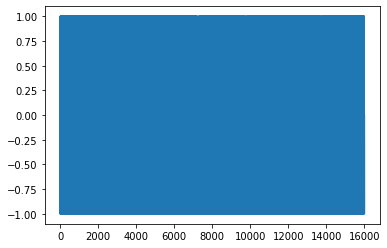

In [112]:
norm_segmented_clips = normalize_audio(segmented_clips)
plt.plot(norm_segmented_clips[0][0,:])
print(norm_segmented_clips[0].shape)
IPython.display.Audio(data=norm_segmented_clips[0][1,:],rate=audio_clips[0,1])

In [113]:
mfccs_speech  = []
s_test_y = []
for i in range(len(norm_segmented_clips)):
    x = mfcc(norm_segmented_clips[i],16000,norm=True)
    y = hzcrr(norm_segmented_clips[i])  
    
        #####LSTER#######
    signal = norm_segmented_clips[i]
    lster_signal = []
    for j in range(len(signal)):
        frames = calcFrames(signal[j],400)
        frames_energy = calcFramesEnergy(frames)
        avg_ste = avg_stEnergy(frames_energy)
        lster_sig = lster(frames_energy)
        lster_signal.append(lster_sig)
    lster_signal = np.array(lster_signal)
    
    
    z = np.zeros((len(x),99))
    q = np.zeros((len(x),99))
    #print(z.shape)
    for k in range(len(z)):
        z[k] = y[k]
        q[k] = lster_signal[k]    
    p = np.dstack((x,z))
    w = np.dstack((p,q))
    print(w.shape)    
    s_test_y.append(np.zeros(np.shape(w)[0]))
    mfccs_speech.append(w)  

(131, 99, 62)
(231, 99, 62)
(889, 99, 62)
(415, 99, 62)
(415, 99, 62)
(681, 99, 62)
(668, 99, 62)
(202, 99, 62)
(194, 99, 62)
(380, 99, 62)
(121, 99, 62)
(62, 99, 62)
(499, 99, 62)
(180, 99, 62)
(658, 99, 62)
(108, 99, 62)
(251, 99, 62)
(451, 99, 62)
(118, 99, 62)
(120, 99, 62)
(252, 99, 62)
(318, 99, 62)
(799, 99, 62)
(407, 99, 62)
(329, 99, 62)
(646, 99, 62)
(173, 99, 62)
(548, 99, 62)
(384, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(536, 99, 62)
(600, 99, 62)
(599, 99, 62)
(600, 99, 62)
(599, 99, 62)
(600, 99, 62)
(600, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(600, 99, 62)
(599, 99, 62)
(567, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(599, 99, 62)
(600, 99, 62)
(599, 99, 62)
(599, 99, 62)


In [114]:
mfccs_speech_test = np.asarray(mfccs_speech) #array of mfcc for each 1 second clip of audio file

# Reshape to create array of mfccs of all audio
mfccs_speech_reshape = []
for i in range(len(norm_segmented_clips)):
    a,b,c = np.shape(mfccs_speech[i])
    #print(b,c)
    mfccs_speech_reshape.append(np.reshape(mfccs_speech[i], (a*b,c)))

mfccs_speech_reshape = np.asarray(mfccs_speech_reshape) # array of all 1 second clip mfcc for length of audio
print(mfccs_speech_reshape[0].shape)

# Reshape to create 2d array of all mfccs of all audio files
n = len(mfccs_speech_reshape)
all_mfccs_speech = np.concatenate(mfccs_speech_reshape[np.linspace(0,n-1,num=n,dtype=int)])
print(all_mfccs_speech.shape)

(12969, 62)
(2882187, 62)


In [115]:
# np.random.shuffle(all_mfccs_speech)
speech_test_x = all_mfccs_speech
print(speech_test_x.shape)
speech_test_y = np.zeros((len(speech_test_x)),dtype=int)
print(speech_test_y.shape)

(2882187, 62)
(2882187,)


In [116]:
# predict = lr.predict(speech_test_x)
# print("Accuary: %f" % accuracy_score(predict,speech_test_y))
# # print(f1_score(predict,Y_train,average='binary'))
# # print(recall_score(predict,Y_train,average=None, pos_label=1))
# # print("Precision: %f" % precision_score(predict,speech_test_y))

In [117]:
path =r"D:\Own set\Music&Env_Test"
audio_clips = read_audio(path)
IPython.display.Audio(data=audio_clips[0][0],rate=audio_clips[0,1])

156
(252, 16000)


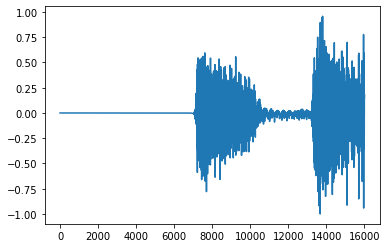

In [118]:
segmented_clips = []
for i in range(len(audio_clips)):
    segmented_clips.append(split_audio(audio_clips[i,0],audio_clips[i,1], 1))

segmented_clips = np.asarray(segmented_clips)
print(len(segmented_clips))

norm_segmented_clips = normalize_audio(segmented_clips)
plt.plot(norm_segmented_clips[0][0,:])
print(norm_segmented_clips[0].shape)
IPython.display.Audio(data=norm_segmented_clips[0][1,:],rate=audio_clips[0,1])

In [119]:
mfccs_non_speech  = []
ns_test_y = []
for i in range(len(norm_segmented_clips)):
    x = mfcc(norm_segmented_clips[i],16000,norm=True)
    y = hzcrr(norm_segmented_clips[i])  
    
        #####LSTER#######
    signal = norm_segmented_clips[i]
    lster_signal = []
    for j in range(len(signal)):
        frames = calcFrames(signal[j],400)
        frames_energy = calcFramesEnergy(frames)
        avg_ste = avg_stEnergy(frames_energy)
        lster_sig = lster(frames_energy)
        lster_signal.append(lster_sig)
    lster_signal = np.array(lster_signal)
    
    
    z = np.zeros((len(x),99))
    q = np.zeros((len(x),99))
    #print(z.shape)
    for k in range(len(z)):
        z[k] = y[k]
        q[k] = lster_signal[k]    
    p = np.dstack((x,z))
    w = np.dstack((p,q))
    print(w.shape)    
    ns_test_y.append(np.ones(np.shape(w)[0]))
    mfccs_non_speech.append(w)  

(252, 99, 62)
(227, 99, 62)
(270, 99, 62)
(176, 99, 62)
(148, 99, 62)
(284, 99, 62)
(674, 99, 62)
(379, 99, 62)
(667, 99, 62)
(295, 99, 62)
(981, 99, 62)
(630, 99, 62)
(533, 99, 62)
(117, 99, 62)
(248, 99, 62)
(190, 99, 62)
(150, 99, 62)
(191, 99, 62)
(206, 99, 62)
(199, 99, 62)
(76, 99, 62)
(222, 99, 62)
(214, 99, 62)
(142, 99, 62)
(244, 99, 62)
(365, 99, 62)
(166, 99, 62)
(11, 99, 62)
(3, 99, 62)
(9, 99, 62)
(12, 99, 62)
(16, 99, 62)
(1, 99, 62)
(3, 99, 62)
(21, 99, 62)
(18, 99, 62)
(24, 99, 62)
(67, 99, 62)
(22, 99, 62)
(22, 99, 62)
(42, 99, 62)
(21, 99, 62)
(5, 99, 62)
(51, 99, 62)
(1, 99, 62)
(7, 99, 62)
(30, 99, 62)
(4, 99, 62)
(45, 99, 62)
(76, 99, 62)
(42, 99, 62)
(20, 99, 62)
(18, 99, 62)
(31, 99, 62)
(28, 99, 62)
(4, 99, 62)
(16, 99, 62)
(44, 99, 62)
(17, 99, 62)
(41, 99, 62)
(168, 99, 62)
(28, 99, 62)
(44, 99, 62)
(20, 99, 62)
(40, 99, 62)
(13, 99, 62)
(53, 99, 62)
(18, 99, 62)
(15, 99, 62)
(8, 99, 62)
(9, 99, 62)
(13, 99, 62)
(14, 99, 62)
(23, 99, 62)
(10, 99, 62)
(4, 99, 6

In [120]:
mfccs_non_speech_test = np.asarray(mfccs_non_speech) #array of mfcc for each 1 second clip of audio file

# Reshape to create array of mfccs of all audio
mfccs_non_speech_reshape = []
for i in range(len(norm_segmented_clips)):
    a,b,c = np.shape(mfccs_non_speech[i])
    #print(b,c)
    mfccs_non_speech_reshape.append(np.reshape(mfccs_non_speech[i], (a*b,c)))

mfccs_non_speech_reshape = np.asarray(mfccs_non_speech_reshape) # array of all 1 second clip mfcc for length of audio
print(mfccs_non_speech_reshape[0].shape)

# Reshape to create 2d array of all mfccs of all audio files
n = len(mfccs_non_speech_reshape)
all_mfccs_non_speech = np.concatenate(mfccs_non_speech_reshape[np.linspace(0,n-1,num=n,dtype=int)])
print(all_mfccs_non_speech.shape)

(24948, 62)
(1127115, 62)


In [121]:
# np.random.shuffle(all_mfccs_non_speech)
non_speech_test_x = all_mfccs_non_speech
print(non_speech_test_x.shape)
non_speech_test_y = np.ones((len(non_speech_test_x)),dtype=int)
print(non_speech_test_y.shape)

(1127115, 62)
(1127115,)


In [122]:
# 1 Second Test

second_test_x = np.append(mfccs_speech_test,mfccs_non_speech_test)
second_test_y = np.append(s_test_y,ns_test_y)
print(second_test_x.shape)
print(second_test_y.shape)

(216,)
(216,)


In [123]:
# 25ms Test
x_test = np.concatenate((speech_test_x,non_speech_test_x))
y_test = np.concatenate((speech_test_y, non_speech_test_y))
print(x_test.shape)
print(y_test.shape)

# with open('Y_test.data', 'wb') as filehandle:
#     # store the data as binary data stream
#     pickle.dump(y_test, filehandle)

# with open('X_test.data', 'wb') as filehandle:
#     # store the data as binary data stream
#     pickle.dump(x_test, filehandle)

x_test, y_test = shuffle(x_test, y_test, random_state = 1)

(4009302, 62)
(4009302,)


In [125]:
#Test GMM
import time
# for n in range(len(s_gmm)):
#     pred_y = []
#     for i in range(len(x_test[:288000])):
#         speech_score = s_gmm[n].score(np.reshape(x_test[i],(1,-1)))
#         non_speech_score = ns_gmm[n].score(np.reshape(x_test[i],(1,-1)))
#         #print(speech_score,non_speech_score)

#         if speech_score > non_speech_score:
#             c+=1
#             pred_y = np.append(pred_y,0)
#         else:
#             pred_y = np.append(pred_y,1)
#     #print(c)
#     print(accuracy_score(pred_y,y_test[:288000]))
#     print("######")

for n in range(len(s_gmm)):
#     pred_y = []
    start = time.time()
    speech_score = s_gmm[n].score_samples(x_test[:2400,:20])
    non_speech_score = ns_gmm[n].score_samples(x_test[:2400, :20])
        #print(speech_score,non_speech_score)
    comb = np.stack((speech_score,non_speech_score),axis=1)
#     print(comb.shape)
    pred_y = np.argmax(comb,axis=1)
#     print(pred[0:200])
#     print(pred)
#     if speech_score > non_speech_score:
#         c+=1
#         pred_y = np.append(pred_y,0)
#     else:
#         pred_y = np.append(pred_y,1)
#     #print(c)
    end = time.time()    
    total = end - start
    print("Accuracy: %f" % accuracy_score(pred_y,y_test[:2400]))
    print("Precision: %f" % precision_score(pred_y, y_test[:2400],pos_label=0))
    print("Time elapsed: %f" % (total))
    print("######")

Accuracy: 0.867917
Precision: 0.915517
Time elapsed: 0.029889
######
Accuracy: 0.865833
Precision: 0.921839
Time elapsed: 0.041887
######
Accuracy: 0.857083
Precision: 0.925287
Time elapsed: 0.077791
######


In [111]:
filename = 's_model_62.sav'
pickle.dump(s_gmm[2], open(filename, 'wb'))

filename = 'ns_model_62.sav'
pickle.dump(ns_gmm[2], open(filename, 'wb'))

In [26]:
s_model = pickle.load(open('s_model_62.sav', 'rb'))
# ns_model = pickle.load(open('ns_model_62.sav', 'rb'))
c_model = pickle.load(open(r'C:\Users\Christiaan\OneDrive\Skripsie\Code\Notebooks\Child speech\child_model_62.sav', 'rb'))

In [53]:
second_test_x_shuffle, second_test_y_shuffle = shuffle(second_test_x,second_test_y, random_state = 1)
# print(second_test_y_shuffle)

In [28]:
# print(second_test_x_shuffle[0].shape)


# print(len(second_test_x_shuffle))
# x = 0
# b = 0
# feat_labels = []
# for j in range(len(second_test_x_shuffle)):

#     test = second_test_x_shuffle[j]
#     mfcc_label = np.empty((len(test)),dtype=int)
#     for i in range(len(test)):
# #         print(test[i,:,:20].shape)
#         speech_gmm = s_model.score(test[i])
#         mix_gmm = ns_model.score(test[i])
#         if speech_gmm > mix_gmm:
#             mfcc_label[i] = 0
#         else:
#             mfcc_label[i] = 1
#         x += 1
# #         if x == 21600:
# #             b = 1
# #             break
# #     if b == 1:
# #         break
#     feat_labels.append(mfcc_label)
# feat_labels = np.array(feat_labels)


c = 0
t = 0
for i in range(len(all_mfccs_speech[10000])):
    child_score = c_model.score(all_mfccs_speech[i].reshape(1,-1))
    adult_score = s_model.score(all_mfccs_speech[i].reshape(1,-1))
    if child_score > adult_score:
        c+=1
    t += 1    
print(c)
print(t)
print(c/t * 100)

2
62
3.225806451612903


In [31]:
####### FROM LOAD MODELS
y_flat_trimmed = []

c = 0
tot_len = 0
x = 0
mfcc_labels = []
time_labels = []

# print(second_test_x_shuffle)

all_probs = []
for j in range(len(mfccs_speech)):
    test = mfccs_speech[j]
    #test2 = test_time_feat[j]
    print(test.shape)
    tot_len += len(test) 

    mfccs_prob = []
    for i in range(len(test)):

        
#         speech_gmm = s_model.score_samples(test[i])
#         mix_gmm = ns_model.score_samples(test[i])
        speech_gmm = c_model.score(test[i])
        mix_gmm = s_model.score(test[i])
        
        p = np.exp(speech_gmm)/(np.exp(speech_gmm)+np.exp(mix_gmm))
        mfccs_prob.append(p)
    mfccs_prob = np.array(mfccs_prob)
    all_probs.append(mfccs_prob)
all_probs = np.array(all_probs)

second_probs = []
for i in range(len(all_probs)):
    p = []
    for j in range(len(all_probs[i])):
        tot = np.sum(all_probs[i][j])
        prob = tot/len(all_probs[i][j])
        p.append(prob)
    p = np.asarray(p)
    second_probs.append(p)
second_probs = np.asarray(second_probs)

print(second_probs[0])

import matplotlib.axes as axes
probs_thershold = []
t = 0
c = 0
save_all = []
for i in range(len(second_probs)):
    x = second_probs[i]
    #print(x.shape)
    y = []
    save = []
    for j in range(len(x)):
        k = x[j]
        #print(k)
        t+=1
        if k < 0.7 and k > 0.3:
            #print(k)
            c +=1
            save = np.append(save,0)
#             pass
        else:
            y_flat_trimmed.append(second_test_y_shuffle[i][j])
            y = np.append(y, k)
            if k > 0.7:
                save = np.append(save,1)
                
            else:
                save = np.append(save,0)
    save_all.append(save)
    y = np.asarray(y)
    #print(y.shape)
       
    probs_thershold.append(y)
probs_thershold = np.asarray(probs_thershold)
print(probs_thershold.shape)
print(c)
print(t)

mfccs_labeled = []
for i in range(len(probs_thershold)):
    x = []
    for j in range(len(probs_thershold[i])):
        if probs_thershold[i][j] > 0.5:
            x.append(0)
        else:
            x.append(1)
    x = np.asarray(x)
    mfccs_labeled.append(x)
mfccs_labeled = np.asarray(mfccs_labeled)
print(mfccs_labeled[0])

t = 0
c = 0
for i in range(len(mfccs_labeled)):
    t += len(mfccs_labeled[i])
#     for j in range(len(mfccs_labeled[i])):
#         print(mfccs_labeled[i])
    c += np.sum(mfccs_labeled[i])
print(t)
print(c)

(1275, 99, 62)
(113, 99, 62)
(163, 99, 62)


TypeError: object of type 'numpy.float64' has no len()

In [85]:
n = len(mfccs_labeled)
q = np.concatenate(mfccs_labeled[np.linspace(0,n-1,num=n,dtype=int)])

print(accuracy_score(q,y_flat_trimmed))
print(precision_score(q,y_flat_trimmed))
print(confusion_matrix(q,y_flat_trimmed))


ValueError: Found input variables with inconsistent numbers of samples: [40498, 0]

In [86]:
# l = 0
# c = 0
# for i in range(len(feat_labels)):
#     l += len(feat_labels[i])
# #     c += np.sum(feat_labels[i])
print(feat_labels.shape)
n = len(feat_labels)
flat_x = np.concatenate(feat_labels[np.linspace(0,n-1,num=n,dtype=int)])
flat_y = np.concatenate(second_test_y_shuffle[np.linspace(0,n-1,num=n,dtype=int)])
print(flat_y.shape,flat_x.shape)

cm = confusion_matrix(flat_x,flat_y)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print(cm)
print(accuracy_score(flat_x,flat_y))
print(precision_score(flat_x,flat_y))

(216,)
(40498,) (40498,)
[[0.98708281 0.01291719]
 [0.0707778  0.9292222 ]]
0.9701466739098227
0.9675010979358806


In [198]:
# probs = lr.predict_proba(speech_test_x)
# HT = 0.6
# LT = 0.4

# print(probs.shape)
# c = 0
# x = []
# y = []
# for i in range(len(probs)):
#     if probs[i,0] < HT and probs[i,0] > LT:
#         c += 1
#         #print(probs[i])
#     else:
#         x.append(probs[i])
#         y.append(Y_train[i])
# print(c)
# x = np.asarray(x)
# y = np.asarray(y)
# print(x.shape)
# x = np.argmax(x,axis=1)
# print(accuracy_score(x,y))


(2882187, 2)
297580
(2584607, 2)
0.6602415763789233


In [52]:
# from scipy.signal import medfilt
# filtered = medfilt(x, kernel_size=5)

In [112]:
# print(accuracy_score(filtered,y))
# #print(filtered[1000:1500])


In [113]:
# predict = postprocess(predict)

In [114]:
# print(accuracy_score(predict,Y_train))

In [115]:
# # n = len(mfccs_speech_reshape)
# # # x_test = np.concatenate(mfccs_speech_reshape[np.linspace(0,n-1,num=n,dtype=int)])
# # x_test = all_mfccs_speech
# # y_test = np.zeros((len(x_test)))
# # print(x_test.shape)
# # print(accuracy_score(lr.predict(x_test),y_test))
# # probs = lr.predict_proba(x_test)
# # HT = 0.6
# # LT = 0.4

# # print(probs.shape)
# # c = 0
# # x = []
# # y = []
# # for i in range(len(probs)):
# #     if probs[i,0] < HT and probs[i,0] > LT:
# #         c += 1
# #         #print(probs[i])
# #     else:
# #         x.append(probs[i])
# #         y.append(y_test[i])
# # print(c)
# # x = np.asarray(x)
# # y = np.asarray(y)
# # print(x.shape)
# # x = np.argmax(x,axis=1)
# # print(accuracy_score(x,y))
# # filtered = medfilt(x, kernel_size=5)
# # print(accuracy_score(filtered,y))
# # print(mfccs_speech_reshape[0].shape)

# c = 0
# t = 0
# d = 0
# all_classified = []
# print(mfccs_speech[0].shape)
# for i in range(len(mfccs_speech)):
#     test = mfccs_speech[i]
#     #print(test.shape)
#     classified = np.empty((len(test)),dtype=int)
#     prob_sum = 0
#     second_cl = []
#     for j in range(len(test)): # seconds
#         print(test[j].shape)
#         p = lr.predict_proba(test[j])
#         print(p.shape)
#         #total = np.sum(p)
#         avg = np.mean(p,axis=0)
#         print(avg)
#         second_cl.append(avg[0])
#     all_classified.append(second_cl)
# all_classified = np.array(all_classified)
# print(all_classified.shape)

# #         remaining = []
# #         for k in range(len(p)):
# #             if p[k,0] < 0.6 and p[k,0] > 0.4:
# #                 c+=1
# #             else:
# #                 remaining.append(p[k])
# #                 d+=1
# #         remaining = np.array(remaining)
# #         #print(remaining)
# #         s = np.sum(remaining, axis=0)
# #         #print(s)
# # #         s = s/len(remaining)
# # #         if s[0] < 0.6 and s[0] > 0.4:
# # #             t+=1
# # #         else:
# #         second_cl.append(np.argmax(s))
# #     second_cl = np.array(second_cl)
# #     print(second_cl)
# #     all_classified.append(second_cl)

# # print(c)
# # print(t)
# # print(d)
# # t = 0
# # c = 0
# # all_classified = np.array(all_classified)
# # print(all_classified.shape)
# # for i in range(len(all_classified)):
# #     #print(all_classified[i])
# #     filtered = medfilt(all_classified[i], kernel_size=5)
# #     print(filtered)
# #     t += len(filtered)
# #     c += np.sum(filtered)

# # print(c)
# # print(t)
# #         if p == 0:
# #     #       if total<50:
# #             c+=1
# #             classified[j] = 0
# #         else:
# #             classified[j] = 1
# #     second_cl.append(classified)



(131, 99, 62)
(99, 62)


NameError: name 'lr' is not defined

In [257]:
def thershold():
    import matplotlib.axes as axes
    probs_thershold = []
    t = 0
    c = 0
    plt.figure(figsize=(12,4))
    ax = plt.scatter(np.linspace(0,len(second_probs[10])-1,len(second_probs[10])),second_probs[10])
    plt.plot(np.full((len(second_probs[10])),0.6))
    plt.plot(np.full((len(second_probs[10])),0.4))
    plt.show()

    for i in range(len(second_probs)):
        x = second_probs[i]
        #print(x.shape)
        y = []
        for j in range(len(x)):
            k = x[j]
            #print(k)
            t+=1
            if k < 0.6 and k > 0.4:
                #print(k)
                c +=1
                pass
            else:
                y = np.append(y, k)
        y = np.asarray(y)
        #print(y.shape)

        probs_thershold.append(y)
    probs_thershold = np.asarray(probs_thershold)
    #print(probs_thershold.shape)
    print(c)
    print(t)

    plt.figure(figsize=(12,4))
    ax = plt.scatter(np.linspace(0,len(probs_thershold[10])-1,len(probs_thershold[10])),probs_thershold[10])
    plt.plot(np.full((len(probs_thershold[10])),0.6))
    plt.plot(np.full((len(probs_thershold[10])),0.4))
    plt.show()
    
    return probs_thershold

def median_filter():
    # Apply medfilter
    from scipy.signal import medfilt
    filtered = []
    #t = 0
    for i in range(len(probs_thershold)):
        filtered.append(medfilt(probs_thershold[i],kernel_size=5))
        #print(1-np.sum(filtered[i])/len(filtered[i]))
        #c+=np.sum(filtered[i])
        #t+= len(filtered[i])
    #print(filtered)
    filtered = np.asarray(filtered)
    #print(filtered[0])
    
    return filtered

def label():
    # Hard label probabilities
    mfccs_labeled = []
    for i in range(len(filtered)):
        x = []
        for j in range(len(filtered[i])):
            if filtered[i][j] > 0.5:
                x.append(0)
            else:
                x.append(1)
        x = np.asarray(x)
        mfccs_labeled.append(x)
    mfccs_labeled = np.asarray(mfccs_labeled)
    print(mfccs_labeled[10])    
    return mfccs_labeled
#     import array_to_latex as a2l
#     text = a2l.to_ltx(mfccs_labeled[0],arraytype='array',frmt='{:.0f}')
#     print(text)

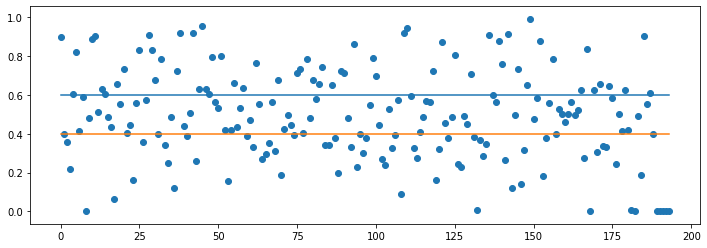

3330
13755


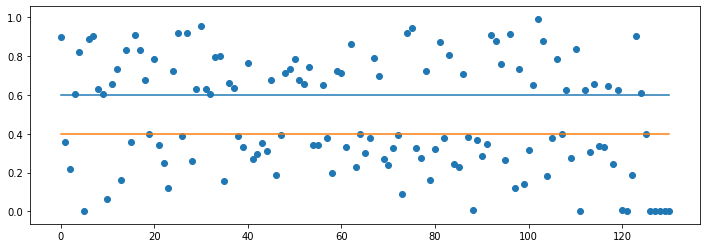

[1 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 1 1 1 0 0 0 0 0 1 1 1 0 1 0
 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [258]:
second_probs = all_classified
probs_thershold = thershold()
filtered = median_filter()
mfccs_labeled = label()


In [259]:
c = 0
t = 0
for i in range(len(mfccs_labeled)):
    t += len(mfccs_labeled[i])
#     for j in range(len(mfccs_labeled[i])):
    #print(mfccs_labeled[i])
    c += np.sum(mfccs_labeled[i])
print(t)
print(c)

10425
2280
